### 1.baseline在不同seed下的组内相似度比较
#### 取100张原图→每组第一句话共100句话→100张生成图


In [1]:
import json
img_text_dic = {}
cnt = 0 
with open("metadata_test.jsonl") as fin:
    for line in fin.readlines():
        if(cnt>=100):break
        tmp_dic = json.loads(line)
        #只筛选每张原始图片对应第一句话
        if('_0' in tmp_dic["file_name"]):
            cnt += 1
            img_text_dic[tmp_dic["file_name"]] = tmp_dic["text"]
#         print(tmp_dic["file_name"],tmp_dic["text"])
# print(len(img_text_dic))

In [2]:
import os
# os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import json
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
import clip


In [3]:
model, preprocess = clip.load('ViT-B/32')

# model.cuda().eval()
model.eval()

CLIP(
  (visual): VisionTransformer(
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): Sequential(
        (0): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
        )
        (1): ResidualAttentionBlock(
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          

In [4]:
text = []

for i, item in enumerate(img_text_dic): 
    cur_text = [img_text_dic[item]]
    text.append(cur_text)

In [5]:
images = []

# def var_name(var,all_var=locals()):
#     return [var_name for var_name in all_var if all_var[var_name] is var][0]


for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/baseline/s'+str(path_idx)+'_img_path'
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

# s0_images = images[0:99]
# s1_images = images[100:199]
# s2_images = images[200:299]
# s3_images = images[300:399]
# s4_images = images[400:499]

In [6]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部
#img_features[i:500:100][0:512]是第i+1句text的5个seed的features i:0~99

In [7]:
# img_features[1:500:100].unsqueeze(1).shape

In [8]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
sim = []
for i in range(100):
    sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
sim[0:5]

[0.39, 0.73, 0.67, 0.48, 0.69]

In [9]:
from numpy import *
print('Baseline model:')
print('The average similarity is {}'.format(round(mean(sim)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(sim.index(max(sim)),round(max(sim)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(sim.index(min(sim)),round(min(sim)*100),2))
print('The std of similarity is ',round(std(sim),2))

Baseline model:
The average similarity is 55.47
The max similarity's index is 70, and the max value is 75
The min similarity's index is 64, and the min value is 31
The std of similarity is  0.09


In [10]:
idx = sim.index(min(sim))
print(text[idx],idx)

['A man and a women posing next to one another in front of a table.'] 64


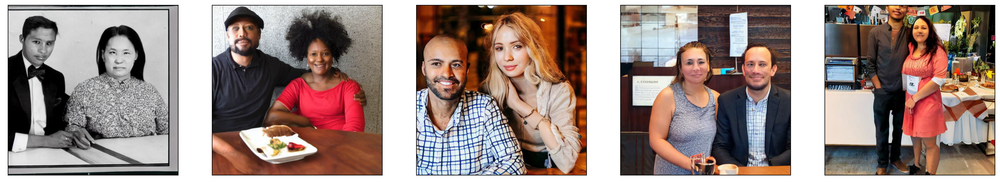

In [13]:
import matplotlib.pyplot as plt
os.environ['KMP_DUPLICATE_LIB_OK']='True'


base_min_img = []
for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/baseline/s'+str(path_idx)+'_img_path'
    item = list(img_text_dic.keys())[idx]
    idx_img = Image.open(os.path.join(path,item)).convert('RGB')
    base_min_img.append(idx_img) 
        
plt.figure(dpi=300,figsize=(24,8))
for i, img in enumerate(base_min_img):
    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### 2.coco model在seed0~4下生成图片间的相似度

In [14]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/coco/s'+str(path_idx)+'_img_path'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/coco/s0_img_path
./images/gen_img/coco/s1_img_path
./images/gen_img/coco/s2_img_path
./images/gen_img/coco/s3_img_path
./images/gen_img/coco/s4_img_path


In [15]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [16]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
coco_sim = []
for i in range(100):
    coco_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
coco_sim[0:5]

simi = coco_sim

In [17]:
from numpy import *
print('coco model:')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model:
The average similarity is 54.83
The max similarity's index is 70, and the max value is 77
The min similarity's index is 33, and the min value is 35
The std of similarity is  0.09


In [18]:
idx2 = coco_sim.index(min(coco_sim))
print(text[idx2],idx2)

['A group of people standing around each other.'] 33


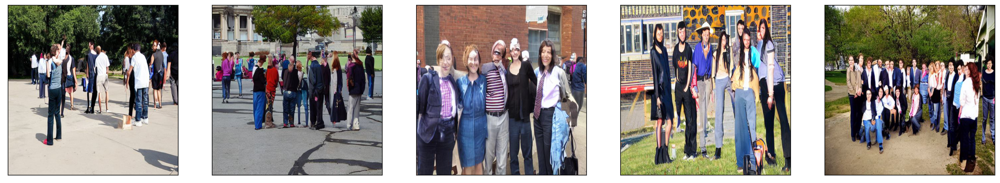

In [20]:
import matplotlib.pyplot as plt
os.environ['KMP_DUPLICATE_LIB_OK']='True'


coco_min_img = []
for path_idx in range(5):
    path = './images/gen_img/coco/s'+str(path_idx)+'_img_path'
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    item = list(img_text_dic.keys())[idx2]
    idx_img = Image.open(os.path.join(path,item)).convert('RGB')
    coco_min_img.append(idx_img) 
        
plt.figure(dpi=300,figsize=(24,8))
for i, img in enumerate(coco_min_img):
    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### 3.coco model bt在seed0~4下生成图片间的相似度

In [21]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/bt/coco-model-bt-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/bt/coco-model-bt-seed0-mini
./images/gen_img/bt/coco-model-bt-seed1-mini
./images/gen_img/bt/coco-model-bt-seed2-mini
./images/gen_img/bt/coco-model-bt-seed3-mini
./images/gen_img/bt/coco-model-bt-seed4-mini


In [22]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [23]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
bt_sim = []
for i in range(100):
    bt_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
bt_sim[0:5]

simi = bt_sim

In [24]:
from numpy import *
print('coco model bt:')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model bt:
The average similarity is 57.74
The max similarity's index is 70, and the max value is 76
The min similarity's index is 33, and the min value is 41
The std of similarity is  0.08


In [25]:
idx3 = bt_sim.index(min(bt_sim))
print(text[idx3],idx3)

['A group of people standing around each other.'] 33


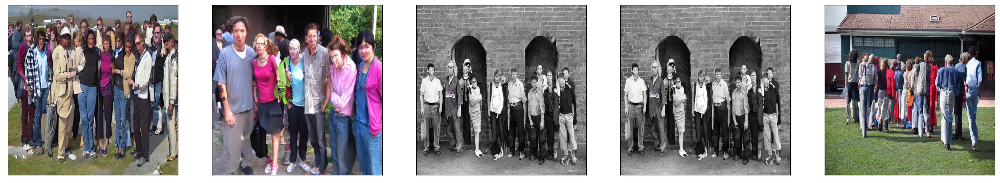

In [26]:
import matplotlib.pyplot as plt
os.environ['KMP_DUPLICATE_LIB_OK']='True'


bt_min_img = []
for path_idx in range(5):
    path = './images/gen_img/bt/coco-model-bt-seed'+str(path_idx)+'-mini'
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    item = list(img_text_dic.keys())[idx3]
    idx_img = Image.open(os.path.join(path,item)).convert('RGB')
    bt_min_img.append(idx_img) 
        
plt.figure(dpi=300,figsize=(24,8))
for i, img in enumerate(bt_min_img):
    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### 4.coco model crop swap在seed0~4下生成图片间的相似度

In [27]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/crop/coco-model-crop_swap-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/crop/coco-model-crop_swap-seed0-mini
./images/gen_img/crop/coco-model-crop_swap-seed1-mini
./images/gen_img/crop/coco-model-crop_swap-seed2-mini
./images/gen_img/crop/coco-model-crop_swap-seed3-mini
./images/gen_img/crop/coco-model-crop_swap-seed4-mini


In [28]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [29]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
crop_sim = []
for i in range(100):
    crop_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
crop_sim[0:5]

simi = crop_sim

In [30]:
from numpy import *
print('coco model crop swap:')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model crop swap:
The average similarity is 53.32
The max similarity's index is 70, and the max value is 76
The min similarity's index is 83, and the min value is 31
The std of similarity is  0.09


In [31]:
idx4 = crop_sim.index(min(crop_sim))
print(text[idx4],idx4)

['A presenter projected on a large screen at a conference.'] 83


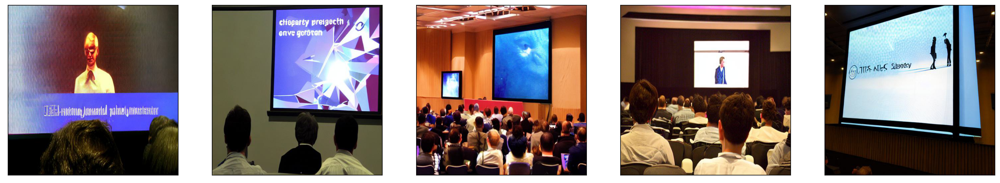

In [32]:
import matplotlib.pyplot as plt
os.environ['KMP_DUPLICATE_LIB_OK']='True'


crop_min_img = []
for path_idx in range(5):
    path = './images/gen_img/crop/coco-model-crop_swap-seed'+str(path_idx)+'-mini'
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    item = list(img_text_dic.keys())[idx4]
    idx_img = Image.open(os.path.join(path,item)).convert('RGB')
    crop_min_img.append(idx_img) 
        
plt.figure(dpi=300,figsize=(24,8))
for i, img in enumerate(crop_min_img):
    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### 5.coco model b1n5在seed0~4下生成图片间的相似度

In [33]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed0-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed1-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed2-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed3-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed4-mini


In [34]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [35]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
b1n5_sim = []
for i in range(100):
    b1n5_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
b1n5_sim[0:5]

simi = b1n5_sim

In [36]:
from numpy import *
print('coco model with linear p beta1 n5 :')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model with linear p beta1 n5 :
The average similarity is 55.19
The max similarity's index is 70, and the max value is 74
The min similarity's index is 33, and the min value is 35
The std of similarity is  0.08


In [37]:
idx5 = b1n5_sim.index(min(b1n5_sim))
print(text[idx5],idx5)

['A group of people standing around each other.'] 33


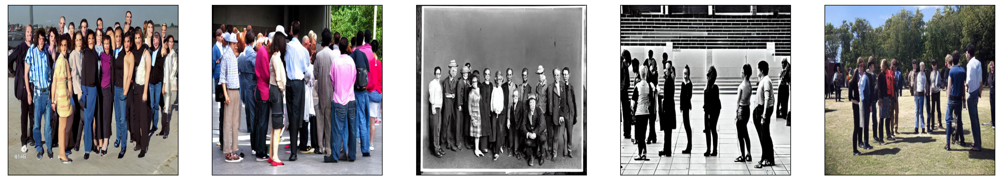

In [38]:
import matplotlib.pyplot as plt
os.environ['KMP_DUPLICATE_LIB_OK']='True'


b1n5_min_img = []
for path_idx in range(5):
    path = './images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed'+str(path_idx)+'-mini'
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    item = list(img_text_dic.keys())[idx5]
    idx_img = Image.open(os.path.join(path,item)).convert('RGB')
    b1n5_min_img.append(idx_img) 
        
plt.figure(dpi=300,figsize=(24,8))
for i, img in enumerate(b1n5_min_img):
    plt.subplot(1, 5, i+1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

### 6.coco model b1n10在seed0~4下生成图片间的相似度

In [24]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/b1n10/coco-model-linear_p_beta1_n10-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed0-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed1-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed2-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed3-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed4-mini


In [25]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [26]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
b1n10_sim = []
for i in range(100):
    b1n10_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
b1n10_sim[0:5]

simi = b1n10_sim

In [27]:
from numpy import *
print('coco model with linear p beta1 n10 :')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model with linear p beta1 n5 :
The average similarity is 55.19
The max similarity's index is 70, and the max value is 74
The min similarity's index is 33, and the min value is 35
The std of similarity is  0.08


In [34]:
idx6 = b1n10_sim.index(min(b1n10_sim))
print(text[idx6],idx6)


['A group of people standing around each other.'] 33


### 7.coco model b1n5在seed0~4下生成图片间的相似度

In [24]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed0-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed1-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed2-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed3-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed4-mini


In [25]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [26]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
b1n5_sim = []
for i in range(100):
    b1n5_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
b1n5_sim[0:5]

simi = b1n5_sim

In [27]:
from numpy import *
print('coco model with linear p beta1 n5 :')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model with linear p beta1 n5 :
The average similarity is 55.19
The max similarity's index is 70, and the max value is 74
The min similarity's index is 33, and the min value is 35
The std of similarity is  0.08


In [34]:
idx5 = b1n5_sim.index(min(b1n5_sim))
print(text[idx5],idx5)

['A group of people standing around each other.'] 33


In [ ]:
### 5.coco model b1n5在seed0~4下生成图片间的相似度

images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
b1n5_sim = []
for i in range(100):
    b1n5_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
b1n5_sim[0:5]

simi = b1n5_sim

from numpy import *
print('coco model with linear p beta1 n5 :')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

idx5 = b1n5_sim.index(min(b1n5_sim))
print(text[idx5],idx5)

### 8.coco model b1n5在seed0~4下生成图片间的相似度

In [24]:
images = []

for path_idx in range(5):
    #同一模型不同seed产生的图片存储的位置，model_name是要手动调换的，例如换成baseline
    path = './images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed'+str(path_idx)+'-mini'
    print(path)
    for i, item in enumerate(img_text_dic):
        cur_image = Image.open(os.path.join(path, item)).convert('RGB')
        cur_image = preprocess(cur_image)
        images.append(cur_image) 

./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed0-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed1-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed2-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed3-mini
./images/gen_img/b1n5/coco-model-linear_p_beta1_n5-seed4-mini


In [25]:
img_inputs = torch.stack(images, dim=0)
with torch.no_grad():
    img_features= model.encode_image(img_inputs)
    
#img_features[0:500]是五个seed的图片的全部

In [26]:
#查看两两之间相似度，0~100和100~200、200~300,…，计算相似度，以此类推。
b1n5_sim = []
for i in range(100):
    b1n5_sim.append(round(F.cosine_similarity(img_features[i:500:100].unsqueeze(0),img_features[i:500:100].unsqueeze(1), dim=-2).mean().item(),2))
b1n5_sim[0:5]

simi = b1n5_sim

In [27]:
from numpy import *
print('coco model with linear p beta1 n5 :')
print('The average similarity is {}'.format(round(mean(simi)*100,2)))
print('The max similarity\'s index is {}, and the max value is {}'.format(simi.index(max(simi)),round(max(simi)*100),2))
print('The min similarity\'s index is {}, and the min value is {}'.format(simi.index(min(simi)),round(min(simi)*100),2))
print('The std of similarity is ',round(std(simi),2))

coco model with linear p beta1 n5 :
The average similarity is 55.19
The max similarity's index is 70, and the max value is 74
The min similarity's index is 33, and the min value is 35
The std of similarity is  0.08


In [34]:
idx5 = b1n5_sim.index(min(b1n5_sim))
print(text[idx5],idx5)

['A group of people standing around each other.'] 33
